In [1]:
path = '/project/CollabRoboGroup/datasets/official_data/' # path for XL
#path = '/project/CollabRoboGroup/datasets/embodied_simulator/official_data/' # path for L

%cd $path
# note that stats1 is for XL dataset and stats2 is for L dataset

/sfs/qumulo/qproject/CollabRoboGroup/datasets/official_data


In [2]:
files = ['train.csv',
            'test.csv',
            'valid.csv']
files = [path+i for i in files]

In [3]:
import csv
from collections import defaultdict

names = {} # dictionary of {name; frequency}
words = {} # dictionary of {word: frequency}

lengths = defaultdict(int) # dictionary of {sentence length: frequency}
count = 0

for file in files:
    print(file)
    with open(file) as f:
        reader = csv.DictReader(f)
        for row in reader:
            
            instruction = row['verbal_instruction']
            name = row['object_category']
            
            if name in names: names[name] += 1
            else: names[name] = 1
            for word in instruction.split(' '):
                if word in words: words[word] += 1
                else: words[word] = 1
            
            lengths[len(str.split(instruction))]+=1
            
                
                    

/project/CollabRoboGroup/datasets/official_data/train.csv
/project/CollabRoboGroup/datasets/official_data/test.csv
/project/CollabRoboGroup/datasets/official_data/valid.csv


In [4]:
top_names = [(names[name], name) for name in names]
top_names = sorted(top_names, key=lambda x:x[0])[57:77]
   
with open('/project/CollabRoboGroup/abg4br/CAESAR-stats/name_stats1.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerow(('Name', 'Frequency'))
    for i in top_names:
        writer.writerow(i[::-1])

In [5]:
lengths_sorted = [(i, lengths[i]) for i in lengths]
lengths_sorted = sorted(lengths_sorted, key=lambda x:x[0])

with open('/project/CollabRoboGroup/abg4br/CAESAR-stats/sentence_stats1.csv', 'w') as f:
    writer = csv.writer(f)
    writer.writerow(('Sentence Length', 'Frequency'))
    for i in lengths_sorted:
        writer.writerow(i)

In [6]:
num = 500
top_words = [(words[word], word) for word in words] # sorted tuples of (frequency, word)
top_words = sorted(top_words, key=lambda x:x[0])
lowest = top_words[0][0]

s = ''
for item in top_words:
    s += (item[1] + ' ') * (int)(item[0]/lowest)

with open('/project/CollabRoboGroup/abg4br/CAESAR-stats/wordcloud1.txt', 'w') as f:
    f.write(s)

# https://www.jasondavies.com/wordcloud/
print("Wordcloud design created at https://www.jasondavies.com/wordcloud/")

Wordcloud design created at https://www.jasondavies.com/wordcloud/


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


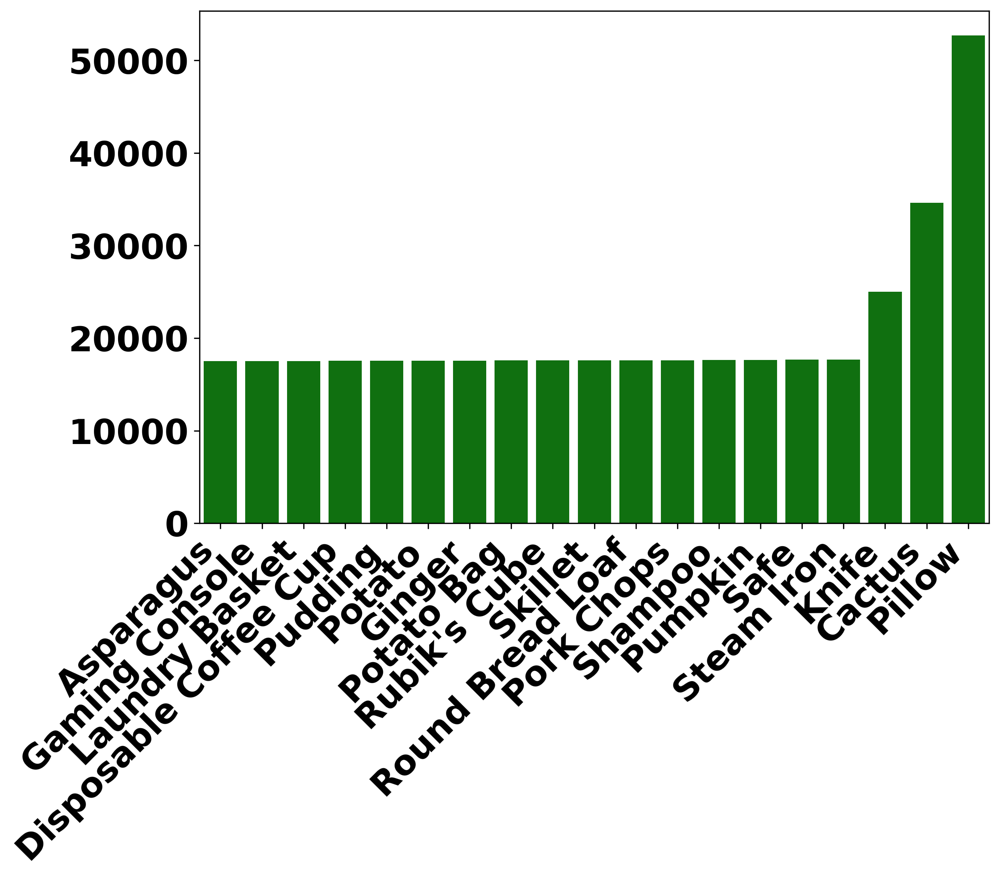

In [7]:
import seaborn as sns
import pandas as pd
import csv
import matplotlib.pyplot as plt
import numpy as np

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 22}

plt.rc('font', **font)

plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
top_names = {'Names':[], 'Frequencies':[]}
with open('/project/CollabRoboGroup/abg4br/CAESAR-stats/name_stats1.csv', 'r') as f:
    csv_reader = csv.reader(f)
    next(csv_reader)
    for i in csv_reader:
        if i[0][-1].isdigit():  top_names['Names'].append(i[0][:-1])
        else: top_names['Names'].append(i[0])
        top_names['Frequencies'].append( i[1])
#top_names = sorted(top_names, key=lambda x:x[0])[:20]
top_names = pd.DataFrame(top_names)
top_names = top_names.explode('Frequencies').reset_index(drop=True)
top_names = top_names.assign(Names=top_names['Names'].astype('category'), 
                       Frequencies=top_names['Frequencies'].astype(np.float32))

fig,ax = plt.subplots(figsize=(9,6))
sns.barplot(x='Names',y='Frequencies',order = top_names.sort_values('Frequencies').Names,
            data=top_names,ci=95,ax=ax, color = 'green')
#ax.yaxis.grid(linewidth=0.5,color='black')
ax.set_xticklabels(top_names.Names, rotation = 45, ha="right")
ax.set_axisbelow(True)
#ax.set_ylim(4700,4850)
#ax.set_yticks(np.arange(4700, 4900, 50), minor = False)
ax.set_ylabel('')
n=ax.set_xlabel('')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/names_frequency.png', bbox_inches="tight")



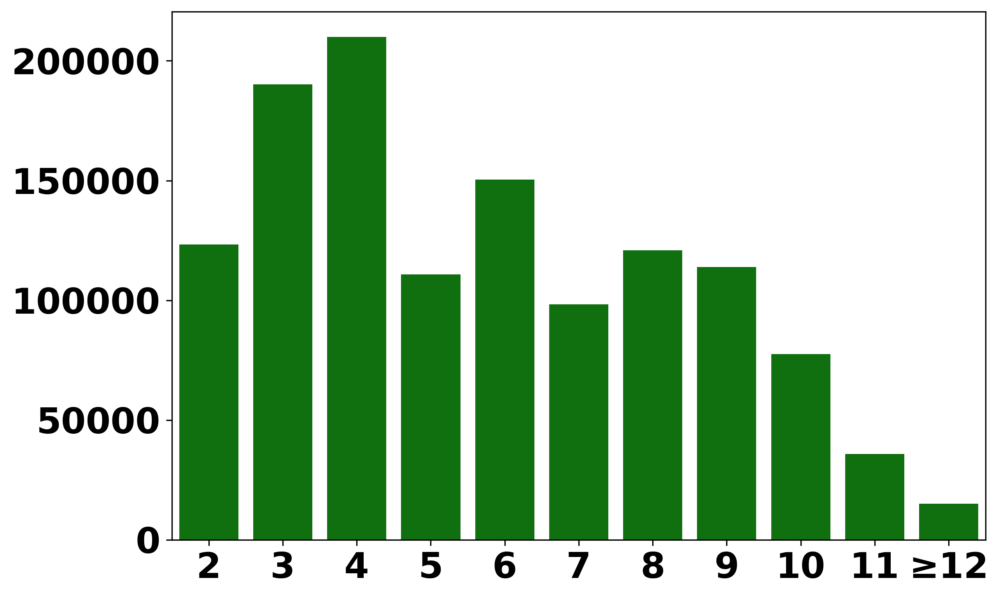

In [8]:
top_lengths = {'Lengths':[], 'Frequencies':[]}
with open('/project/CollabRoboGroup/abg4br/CAESAR-stats/sentence_stats1.csv', 'r') as f:
    csv_reader = csv.reader(f)
    next(csv_reader)
    for i in csv_reader:
        if int(i[0]) > 12:
            top_lengths['Frequencies'][11] += int(i[1])
        elif int(i[0] == 1):
            pass
        else:
            top_lengths['Lengths'].append(int(i[0]))
            top_lengths['Frequencies'].append(int(i[1]))
print()
#print(top_lengths['Lengths'])
top_lengths['Lengths'].remove(1)
top_lengths['Frequencies'].pop(0)
        
top_lengths = pd.DataFrame(top_lengths)
top_lengths = top_lengths.explode('Frequencies').reset_index(drop=True)
top_lengths = top_lengths.assign(Lengths=top_lengths['Lengths'].astype(np.int), 
                       Frequencies=top_lengths['Frequencies'].astype(np.float32))

fig,ax = plt.subplots(figsize=(9,6))
sns.barplot(x='Lengths',y='Frequencies',order = top_lengths.sort_values('Lengths').Lengths,
            data=top_lengths,ci=95,ax=ax, color = 'green')
#ax.yaxis.grid(linewidth=0.5,color='black')
ax.set_axisbelow(True)
ax.set_xticklabels([str(i+2) for i in range(10)]+['≥12'])
ax.set_ylabel('')
n=ax.set_xlabel('')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/instruction_lengths_frequency.png', bbox_inches="tight")


In [9]:
import csv
left_location = {'ego':[], 'exo':[], 'top':[]}
right_location = {'ego':[], 'exo':[], 'top':[]}

front_location = {'ego':[], 'exo':[], 'top':[]}
back_location = {'ego':[], 'exo':[], 'top':[]}

fl_location = {'ego':[], 'exo':[], 'top':[]}
fr_location = {'ego':[], 'exo':[], 'top':[]}

bl_location = {'ego':[], 'exo':[], 'top':[]}
br_location = {'ego':[], 'exo':[], 'top':[]}

center_location = {'ego':[], 'exo':[], 'top':[]}
except_center_location = {'ego':[], 'exo':[], 'top':[]}

for file in files:
    print(file)
    with open(file) as f:
        reader = csv.DictReader(f)
        for row in reader:
            instruction = row['verbal_instruction'].lower()
            #if 'left' not in instruction and 'right' not in instruction: continue
            if '_2_' not in  row['instruction_template']: continue # doing locations for now so only use template 2
            if 'wrong' in row['setting_name']: continue # wrong numbers are not correct
            
            
            for view in ('ego', 'exo', 'top'):                       
                obj_x = (float(row[view+'_view_image_object_start_point_x']) + float(row[view+'_view_image_object_end_point_x']))/2
                obj_y = (float(row[view+'_view_image_object_start_point_y']) + float(row[view+'_view_image_object_end_point_y']))/2
                
                if 'left' in instruction:
                    left_location[view].append([obj_x, obj_y])

                if 'right' in instruction:
                    right_location[view].append([obj_x, obj_y])
                    
                if 'front' in instruction:
                    front_location[view].append([obj_x, obj_y])

                if 'back' in instruction:
                    back_location[view].append([obj_x, obj_y])
                    
                if 'front left' in instruction:
                    fl_location[view].append([obj_x, obj_y])

                if 'front right' in instruction:
                    fr_location[view].append([obj_x, obj_y])
                    
                if 'back left' in instruction:
                    bl_location[view].append([obj_x, obj_y])

                if 'back right' in instruction:
                    br_location[view].append([obj_x, obj_y])
                    
                if 'center' in instruction:
                    center_location[view].append([obj_x, obj_y]) 
                else:
                    except_center_location[view].append([obj_x, obj_y]) 
                

/project/CollabRoboGroup/datasets/official_data/train.csv
/project/CollabRoboGroup/datasets/official_data/test.csv
/project/CollabRoboGroup/datasets/official_data/valid.csv


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


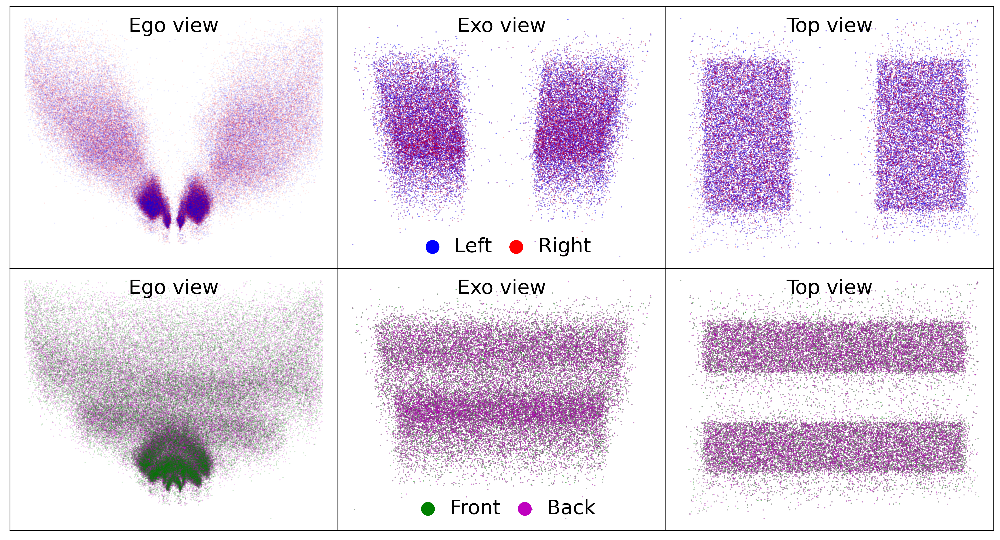

In [10]:
from matplotlib.legend_handler import HandlerLine2D
import random


view_names = ['Ego view', 'Exo view', 'Top view']
views = ['ego', 'exo', 'top']
fig, axs = plt.subplots(2, 3) # is left right 
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 22}

plt.rc('font', **font)
ego_left_1 = left_location['ego'][:len(left_location[view])//2]
ego_left_2 = left_location['ego'][len(left_location[view])//2:]
ego_right_1 = right_location['ego'][:len(right_location[view])//2]
ego_right_2 = right_location['ego'][len(right_location[view])//2:]

ego_front_1 = front_location['ego'][:len(front_location[view])//2]
ego_front_2 = front_location['ego'][len(front_location[view])//2:]
ego_back_1 = back_location['ego'][:len(back_location[view])//2]
ego_back_2 = back_location['ego'][len(back_location[view])//2:]

for i in range(3):
    view = views[i]
    axs[0][i].axes.xaxis.set_visible(False)
    axs[0][i].axes.yaxis.set_visible(False)
    axs[1][i].axes.xaxis.set_visible(False)
    axs[1][i].axes.yaxis.set_visible(False)
    
    axs[0][i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    axs[1][i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    
    if view != 'ego':
        #LR
        axs[0][i].scatter( [x[0] for x in left_location[view]], [x[1] for x in left_location[view]], c='b', label='Left', s=0.2, alpha=0.17)
        axs[0][i].scatter( [x[0] for x in right_location[view]], [x[1] for x in right_location[view]], c='r', label='Right', s=0.1, alpha=0.1)
        #FB
        axs[1][i].scatter( [x[0] for x in front_location[view]], [x[1] for x in front_location[view]], c='g', label='Front', s=0.2, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in back_location[view]], [x[1] for x in back_location[view]], c='m', label='Back', s=0.2, alpha=0.17)
    else:#LR
        axs[0][i].scatter( [x[0] for x in ego_left_1], [x[1] for x in ego_left_1], c='b', label='Left', s=0.2, alpha=0.08)
        axs[0][i].scatter( [x[0] for x in ego_right_1], [x[1] for x in ego_right_1], c='r', label='Right', s=0.2, alpha=0.08)
        
        axs[0][i].scatter( [x[0] for x in ego_right_2], [x[1] for x in ego_right_2], c='r', label='Right', s=0.2, alpha=0.08)
        axs[0][i].scatter( [x[0] for x in ego_left_2], [x[1] for x in ego_left_2], c='b', label='Left', s=0.2, alpha=0.08)  
        #FB
        axs[1][i].scatter( [x[0] for x in ego_front_1], [x[1] for x in ego_front_1], c='g', label='Front', s=0.2, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in ego_back_1], [x[1] for x in ego_back_1], c='m', label='Back', s=0.2, alpha=0.17)
        
        axs[1][i].scatter( [x[0] for x in ego_back_2], [x[1] for x in ego_back_2], c='m', label='Back', s=0.2, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in ego_front_2], [x[1] for x in ego_front_2], c='g', label='Front', s=0.2, alpha=0.17)  
        
    #legend stuff
    if view == 'exo':
        axs[0][i].legend(loc = 'lower center', bbox_to_anchor=(0.5, 0), labelspacing=-1, columnspacing = 0.2, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[0][i].get_legend()
        #leg.legendHandles[0].set_color('blue')
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        #leg.legendHandles[1].set_color('red')
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 
        
        axs[1][i].legend(loc = 'lower center', bbox_to_anchor=(0.5, 0), labelspacing=-1, borderpad=0.1, columnspacing = 0.2, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[1][i].get_legend()
        #leg.legendHandles[0].set_color('blue')
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        #leg.legendHandles[1].set_color('red')
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 
        


fig.set_size_inches(15, 8)
plt.subplots_adjust(left=0,bottom=0,right=1,top=1,wspace=0,hspace=0)

from matplotlib.transforms import Bbox
extent1 = Bbox.from_extents(0, 0, 15, 4)
extent2 = Bbox.from_extents(0, 4, 15, 8)


plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_location_fb.png', bbox_inches = extent1)
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_location_lr.png', bbox_inches = extent2)



In [11]:
left_relation = {'ego':[], 'exo':[], 'top':[]}
right_relation = {'ego':[], 'exo':[], 'top':[]}

front_relation = {'ego':[], 'exo':[], 'top':[]}
back_relation = {'ego':[], 'exo':[], 'top':[]}

next_relation = {'ego':[], 'exo':[], 'top':[]}


for file in files:
    print(file)
    with open(file) as f:
        reader = csv.DictReader(f)
        for row in reader:
            instruction = row['verbal_instruction'].lower()
            if '_2_' in  row['instruction_template']: continue # doing locations for now so only use template 2
            if 'wrong' in row['setting_name']: continue # wrong numbers are not correct
            
            
            for view in ('ego', 'exo', 'top'):                       
                obj_x = (float(row[view+'_view_image_object_start_point_x']) + float(row[view+'_view_image_object_end_point_x']))/2
                obj_y = (float(row[view+'_view_image_object_start_point_y']) + float(row[view+'_view_image_object_end_point_y']))/2
                
                if 'left' in instruction:
                    left_relation[view].append([obj_x, obj_y])

                if 'right' in instruction:
                    right_relation[view].append([obj_x, obj_y])
                    
                if 'front' in instruction:
                    front_relation[view].append([obj_x, obj_y])

                if 'behind' in instruction:
                    back_relation[view].append([obj_x, obj_y])
                    
                if 'next to' in instruction:
                    next_relation[view].append([obj_x, obj_y])

/project/CollabRoboGroup/datasets/official_data/train.csv
/project/CollabRoboGroup/datasets/official_data/test.csv
/project/CollabRoboGroup/datasets/official_data/valid.csv


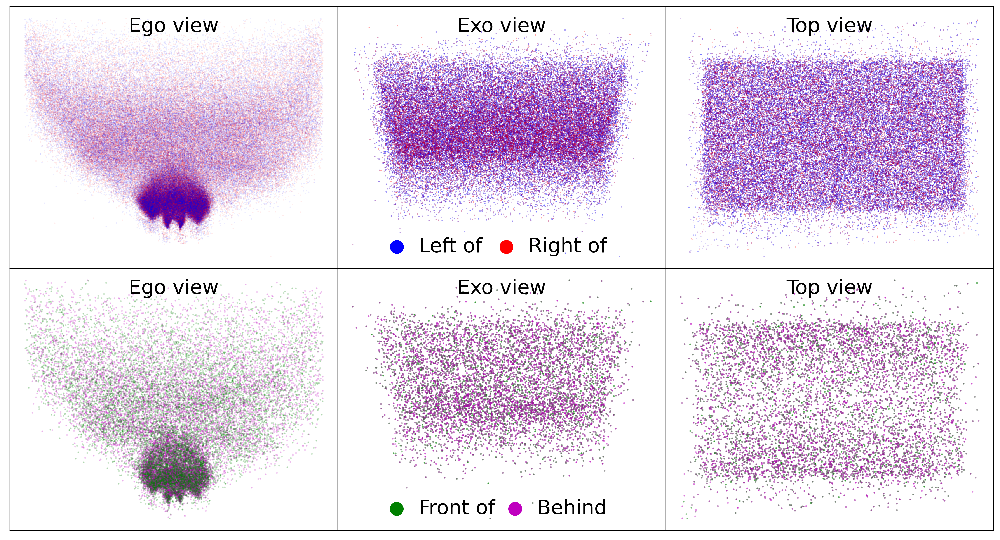

In [12]:
view_names = ['Ego view', 'Exo view', 'Top view']
views = ['ego', 'exo', 'top']
fig, axs = plt.subplots(2, 3) # is left right 


plt.rc('font', **font)
ego_left_1 = left_relation['ego'][:len(left_relation[view])//2]
ego_left_2 = left_relation['ego'][len(left_relation[view])//2:]
ego_right_1 = right_relation['ego'][:len(right_relation[view])//2]
ego_right_2 = right_relation['ego'][len(right_relation[view])//2:]

ego_front_1 = front_relation['ego'][:len(front_relation[view])//2]
ego_front_2 = front_relation['ego'][len(front_relation[view])//2:]
ego_back_1 = back_relation['ego'][:len(back_relation[view])//2]
ego_back_2 = back_relation['ego'][len(back_relation[view])//2:]

for i in range(3):
    view = views[i]
    axs[0][i].axes.xaxis.set_visible(False)
    axs[0][i].axes.yaxis.set_visible(False)
    axs[1][i].axes.xaxis.set_visible(False)
    axs[1][i].axes.yaxis.set_visible(False)
    
    axs[0][i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    axs[1][i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    
    if view != 'ego':
        #LR
        axs[0][i].scatter( [x[0] for x in left_relation[view]], [x[1] for x in left_relation[view]], c='b', label='Left of', s=0.2, alpha=0.17)
        axs[0][i].scatter( [x[0] for x in right_relation[view]], [x[1] for x in right_relation[view]], c='r', label='Right of', s=0.1, alpha=0.1)
        #FB
        axs[1][i].scatter( [x[0] for x in front_relation[view]], [x[1] for x in front_relation[view]], c='g', label='Front of', s=1, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in back_relation[view]], [x[1] for x in back_relation[view]], c='m', label='Behind', s=1, alpha=0.17)
    else:#LR
        axs[0][i].scatter( [x[0] for x in ego_left_1], [x[1] for x in ego_left_1], c='b', label='Left of', s=0.2, alpha=0.08)
        axs[0][i].scatter( [x[0] for x in ego_right_1], [x[1] for x in ego_right_1], c='r', label='Right of', s=0.2, alpha=0.08)
        
        axs[0][i].scatter( [x[0] for x in ego_right_2], [x[1] for x in ego_right_2], c='r', label='Right of', s=0.2, alpha=0.08)
        axs[0][i].scatter( [x[0] for x in ego_left_2], [x[1] for x in ego_left_2], c='b', label='Left of', s=0.2, alpha=0.08)  
        #FB
        axs[1][i].scatter( [x[0] for x in ego_front_1], [x[1] for x in ego_front_1], c='g', label='Front of', s=1, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in ego_back_1], [x[1] for x in ego_back_1], c='m', label='Behind', s=1, alpha=0.17)
        
        axs[1][i].scatter( [x[0] for x in ego_back_2], [x[1] for x in ego_back_2], c='m', label='Behind', s=1, alpha=0.17)
        axs[1][i].scatter( [x[0] for x in ego_front_2], [x[1] for x in ego_front_2], c='g', label='Front of', s=1, alpha=0.17)  
        
    #legend stuff
    if view == 'exo':
        axs[0][i].legend(loc = 'lower center', bbox_to_anchor=(0.47, 0), columnspacing = 0.2, labelspacing=-1, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[0][i].get_legend()
        #leg.legendHandles[0].set_color('blue')
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        #leg.legendHandles[1].set_color('red')
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 
        
        axs[1][i].legend(loc = 'lower center', bbox_to_anchor=(0.47, 0), columnspacing = 0, labelspacing=-1, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[1][i].get_legend()
        #leg.legendHandles[0].set_color('blue')
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        #leg.legendHandles[1].set_color('red')
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 
        


fig.set_size_inches(15, 8)
plt.subplots_adjust(left=0,bottom=0,right=1,top=1,wspace=0,hspace=0)

extent1 = Bbox.from_extents(0, 0, 15, 4)
extent2 = Bbox.from_extents(0, 4, 15, 8)


plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_relation_fb.png', bbox_inches = extent1)
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_relation_lr.png', bbox_inches = extent2)

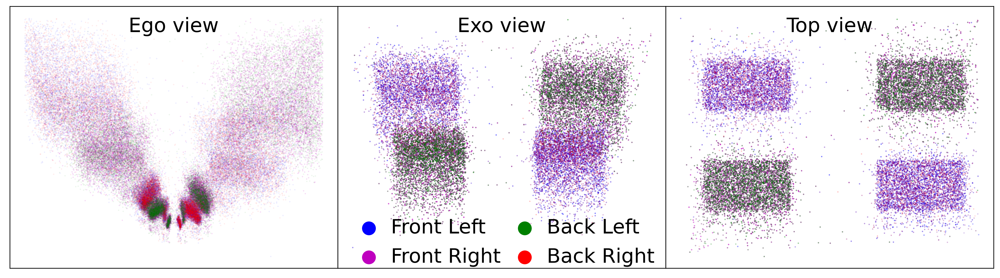

In [51]:
#corner location visualizations do FL with BR and FR with BL

view_names = ['Ego view', 'Exo view', 'Top view']
views = ['ego', 'exo', 'top']
fig, axs = plt.subplots(1, 3) # is left right 
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 22}

plt.rc('font', **font)

plt.rc('font', **font)
ego_fl_1 = fl_location['ego'][:len(fl_location[view])//2]
ego_fl_2 = fl_location['ego'][len(fl_location[view])//2:]
ego_fr_1 = fr_location['ego'][:len(fr_location[view])//2]
ego_fr_2 = fr_location['ego'][len(fr_location[view])//2:]

ego_br_1 = br_location['ego'][:len(br_location[view])//2]
ego_br_2 = br_location['ego'][len(br_location[view])//2:]
ego_bl_1 = bl_location['ego'][:len(bl_location[view])//2]
ego_bl_2 = bl_location['ego'][len(bl_location[view])//2:]

for i in range(3):
    view = views[i]
    axs[i].axes.xaxis.set_visible(False)
    axs[i].axes.yaxis.set_visible(False)
    
    axs[i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    
    if view != 'ego':
        axs[i].scatter( [x[0] for x in fl_location[view]], [x[1] for x in fl_location[view]], c='b', label='Front Left', s=0.2, alpha=0.17)
        axs[i].scatter( [x[0] for x in fr_location[view]], [x[1] for x in fr_location[view]], c='m', label='Front Right', s=0.2, alpha=0.3)
        axs[i].scatter( [x[0] for x in bl_location[view]], [x[1] for x in bl_location[view]], c='g', label='Back Left', s=0.2, alpha=0.17)
        axs[i].scatter( [x[0] for x in br_location[view]], [x[1] for x in br_location[view]], c='r', label='Back Right', s=0.1, alpha=0.1)
    else:
        axs[i].scatter( [x[0] for x in ego_fl_1], [x[1] for x in ego_fl_1], c='b', label='Front Left', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_fr_1], [x[1] for x in ego_fr_1], c='m', label='Front Right', s=0.2, alpha=0.15)
        axs[i].scatter( [x[0] for x in ego_fr_2], [x[1] for x in ego_fr_2], c='m', label='Front Right', s=0.2, alpha=0.15)
        axs[i].scatter( [x[0] for x in ego_fl_2], [x[1] for x in ego_fl_2], c='b', label='Front Left', s=0.2, alpha=0.08)  
        axs[i].scatter( [x[0] for x in ego_bl_1], [x[1] for x in ego_bl_1], c='g', label='Back Left', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_br_1], [x[1] for x in ego_br_1], c='r', label='Back Right', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_br_2], [x[1] for x in ego_br_2], c='r', label='Back Right', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_bl_2], [x[1] for x in ego_bl_2], c='g', label='Back Left', s=0.2, alpha=0.08)  
        
    #legend stuff
    if view == 'exo':
        axs[i].legend(loc = 'lower center', bbox_to_anchor=(0.5, -0.04), columnspacing = 0.2, labelspacing=0.5, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[i].get_legend()
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 
        leg.legendHandles[2].set_alpha(1)
        leg.legendHandles[2]._sizes = [200] 
        leg.legendHandles[3].set_alpha(1)
        leg.legendHandles[3]._sizes = [200] 

        


fig.set_size_inches(15, 4)
plt.subplots_adjust(left=0,bottom=0,right=1,top=1,wspace=0,hspace=0)

plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_corners.png', bbox_inches="tight")


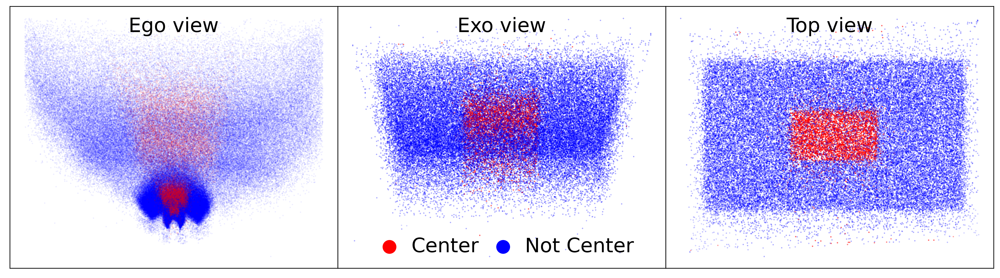

In [14]:
#center vs everything else visualizations
view_names = ['Ego view', 'Exo view', 'Top view']
views = ['ego', 'exo', 'top']
fig, axs = plt.subplots(1, 3) # is left right 

 
ego_center_1 = center_location['ego'][:len(center_location[view])//2]
ego_center_2 = center_location['ego'][len(center_location[view])//2:]
ego_except_center_1 = except_center_location['ego'][:len(except_center_location[view])//2]
ego_except_center_2 = except_center_location['ego'][len(except_center_location[view])//2:]



for i in range(3):
    view = views[i]
    axs[i].axes.xaxis.set_visible(False)
    axs[i].axes.yaxis.set_visible(False)
    
    axs[i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    
    if view != 'ego':
        axs[i].scatter( [x[0] for x in center_location[view]], [x[1] for x in center_location[view]], c='r', label='Center', s=0.2, alpha=0.22)
        axs[i].scatter( [x[0] for x in except_center_location[view]], [x[1] for x in except_center_location[view]], c='b', label='Not Center', s=0.2, alpha=0.1)
    else:
        axs[i].scatter( [x[0] for x in ego_center_1], [x[1] for x in ego_center_1], c='r', label='Center', s=0.2, alpha=0.1)
        axs[i].scatter( [x[0] for x in ego_except_center_1], [x[1] for x in ego_except_center_1], c='b', label='Not Center', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_except_center_2], [x[1] for x in ego_except_center_2], c='b', label='Not Center', s=0.2, alpha=0.08)
        axs[i].scatter( [x[0] for x in ego_center_2], [x[1] for x in ego_center_2], c='r', label='Center', s=0.2, alpha=0.1)  
        
    #legend stuff
    if view == 'exo':
        axs[i].legend(loc = 'lower center', bbox_to_anchor=(0.5, 0), columnspacing = 0.2, labelspacing=0.5, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[i].get_legend()
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 
        leg.legendHandles[1].set_alpha(1)
        leg.legendHandles[1]._sizes = [200] 


        


fig.set_size_inches(15, 4)
plt.subplots_adjust(left=0,bottom=0,right=1,top=1,wspace=0,hspace=0)

plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_center.png', bbox_inches="tight")

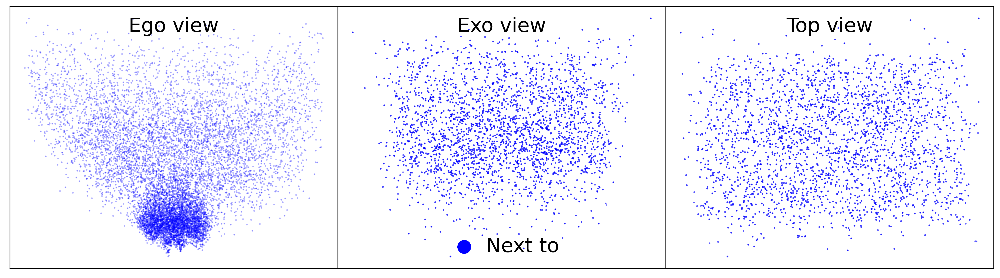

In [15]:
# next to relation visualization
#next_relation
view_names = ['Ego view', 'Exo view', 'Top view']
views = ['ego', 'exo', 'top']
fig, axs = plt.subplots(1, 3) # is left right 



for i in range(3):
    view = views[i]
    axs[i].axes.xaxis.set_visible(False)
    axs[i].axes.yaxis.set_visible(False)
    
    axs[i].set_title(view_names[i], y=1.0, pad=-28, font = font)
    
    axs[i].scatter( [x[0] for x in next_relation[view]], [x[1] for x in next_relation[view]], c='b', label='Next to', s=0.8, alpha=0.25)

        
    #legend stuff
    if view == 'exo':
        axs[i].legend(loc = 'lower center', bbox_to_anchor=(0.5, 0), columnspacing = 0.2, labelspacing=0.5, borderpad=0.1, fancybox=True, framealpha=0, ncol=2, handletextpad=0.1)
        leg = axs[i].get_legend()
        leg.legendHandles[0].set_alpha(1)
        leg.legendHandles[0]._sizes = [200] 



        


fig.set_size_inches(15, 4)
plt.subplots_adjust(left=0,bottom=0,right=1,top=1,wspace=0,hspace=0)

plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/view_verbal_classification_next.png', bbox_inches="tight")

In [16]:
# word/sentence/perspective analysis
instruction_dict = defaultdict(int) # dict of instruction template: frequency
word_dict = defaultdict(int) # dict of word length: frequency
sentence_dict = defaultdict(int) # dict of sentence length: frequency
perspective_dict = defaultdict(int) # dict of instruction perspective: frequency
situation_dict = defaultdict(int)
for i in range(2, 11):
    word_dict[i] = 0
    
for file in files:
    print(file)
    with open(file) as f:
        reader = csv.DictReader(f)
        for row in reader:
            instruction_template = row['instruction_template'].lower()
            instruction_dict[instruction_template]+=1
            
            if 'ego' in instruction_template:
                perspective_dict['Ego']+=1
            elif 'exo' in instruction_template:
                perspective_dict['Exo']+=1
            else: #neutral
                perspective_dict['Neutral']+=1
            
            instruction = row['verbal_instruction']
            for word in str.split(instruction):
                word_dict[len(word)]+=1
            sentence_dict[len(str.split(instruction))]+=1
            
            situation_dict[row['setting_name'].replace('_', ' ')]+=1
            
            
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 22}

plt.rc('font', **font)           
print(situation_dict)      


/project/CollabRoboGroup/datasets/official_data/train.csv
/project/CollabRoboGroup/datasets/official_data/test.csv
/project/CollabRoboGroup/datasets/official_data/valid.csv
defaultdict(<class 'int'>, {'both gaze gesture': 174448, 'only gaze': 174304, 'wrong only gaze': 174304, 'only gesture': 170218, 'wrong only gesture': 170218, 'only objects': 173461, 'wrong only objects': 173461, 'wrong gaze gesture': 156891})


findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


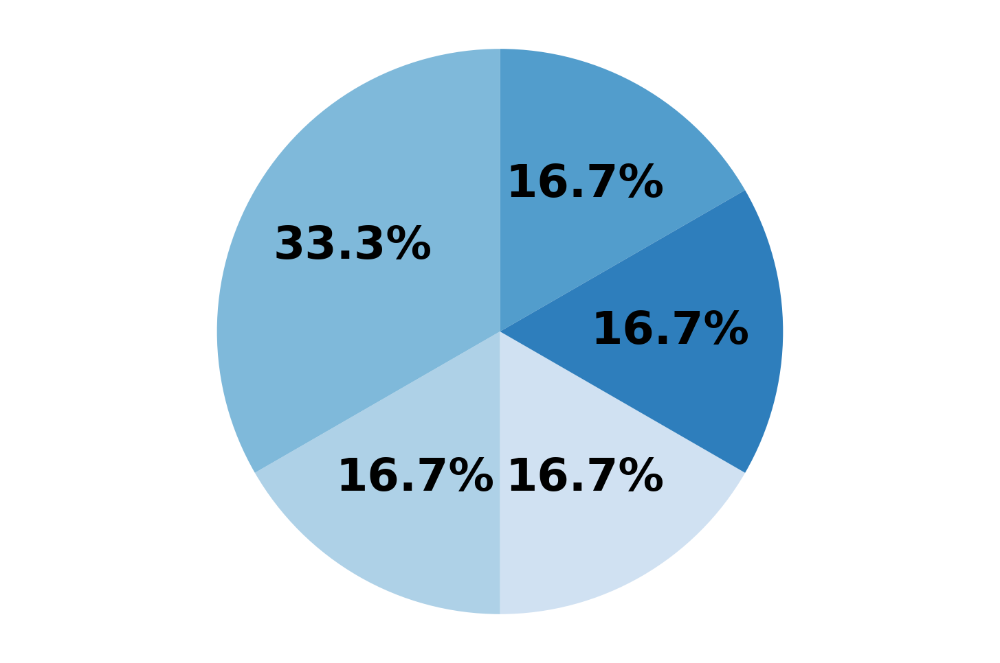

In [17]:
#pie chart for instruction templates
#import matplotlib.pyplot as plt
#import numpy as np
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 16}

plt.rc('font', **font)

grouped_instruction_dict = defaultdict(int)
grouped_instruction_dict['T-1'] = 0
grouped_instruction_dict['T-2'] = 0
grouped_instruction_dict['T-3'] = 0
grouped_instruction_dict['T-4'] = 0
grouped_instruction_dict['T-5'] = 0

for instruction_template in instruction_dict:
    if '1_1' in instruction_template:
        grouped_instruction_dict['T-1']+=instruction_dict[instruction_template]
    elif '1_2' in instruction_template:
        grouped_instruction_dict['T-2']+=instruction_dict[instruction_template]
    elif '_2_' in instruction_template:
        grouped_instruction_dict['T-3']+=instruction_dict[instruction_template]
    elif '3_1' in instruction_template:
        grouped_instruction_dict['T-4']+=instruction_dict[instruction_template]
    elif '3_2' in instruction_template:
        grouped_instruction_dict['T-5']+=instruction_dict[instruction_template]

plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
#print(grouped_instruction_dict)
labels = grouped_instruction_dict.keys()
sizes = grouped_instruction_dict.values()
#colors = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue', 'teal']
#colors = ['#DC1EFC', '#79DB8A', '#F05A29', '#2EA0DB', '#FACF34']
colors = plt.get_cmap('Blues')(np.linspace(0.2, 0.7, len(labels)))

explode = (0.03, 0.03, 0.03, 0.03, 0.03)  # explode 1st slice

# Plot
plt.pie(sizes, colors = colors, pctdistance = 0.6, autopct='%1.1f%%', counterclock = False, startangle=-30, labeldistance=1.2)
#labels=labels, 

plt.axis('equal')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/template_frequency.png', bbox_inches="tight")


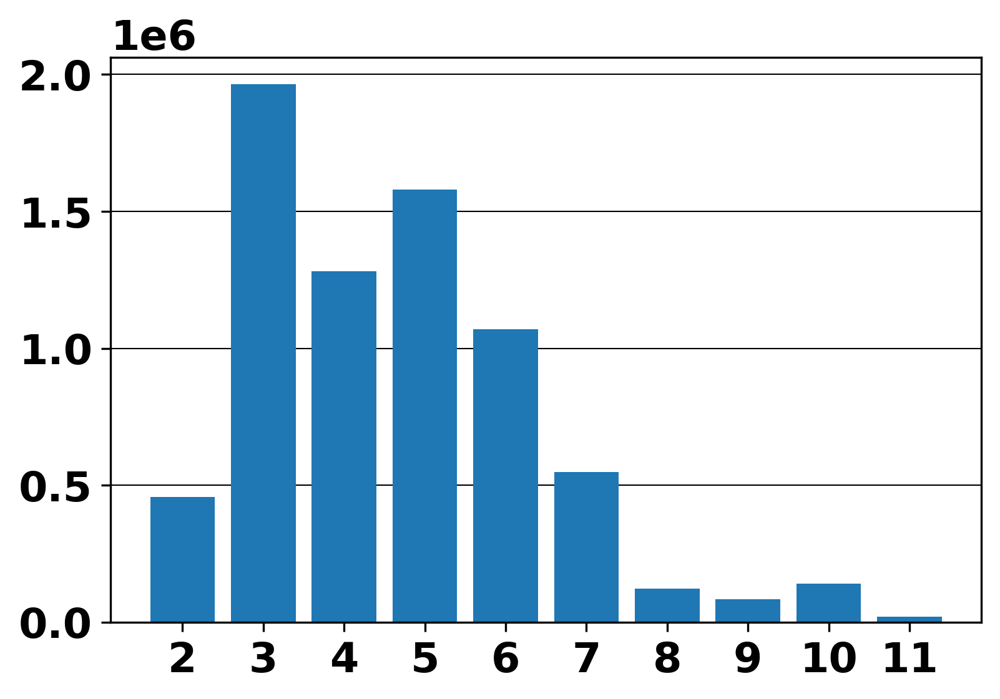

In [18]:
#bar plot for word lengths and frequencies
fig,ax = plt.subplots()
lengths = word_dict.keys()
freq = word_dict.values()
plt.bar(range(len(lengths)), freq, tick_label=lengths)

#plt.bar(x='Word Lengths',y='Frequencies',order = top_lengths.sort_values('Lengths').Lengths, data=word_dict,ci=95,ax=ax, color = 'green')
ax.yaxis.grid(linewidth=0.5,color='black')
ax.set_axisbelow(True)
ax.set_xticklabels(word_dict.keys())
ax.set_ylabel('')
n=ax.set_xlabel('')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/word_length_frequency.png', bbox_inches="tight")

In [19]:
# average word length
total_words = 0
total_characters = 0
for word_length in word_dict.keys():
    total_words+=word_dict[word_length]
    total_characters+=word_dict[word_length] * word_length
    
print("There are a total of " + str(total_characters) + " characters spread across " + str(total_words) + " words.")
print("Average word length is: " + str(total_characters/total_words))
    

There are a total of 33445223 characters spread across 7268239 words.
Average word length is: 4.601557956473363


In [20]:
#average sentence length
total_sentences = 0
total_words = 0
for sentence_length in sentence_dict.keys():
    total_sentences+=sentence_dict[sentence_length]
    total_words+=sentence_dict[sentence_length] * sentence_length
    
print("There are a total of " + str(total_words) + " words spread across " + str(total_sentences) + " sentences.")
print("Average sentence length is: " + str(total_words/total_sentences) + " words.")

There are a total of 7268239 words spread across 1367305 sentences.
Average sentence length is: 5.315740818617646 words.


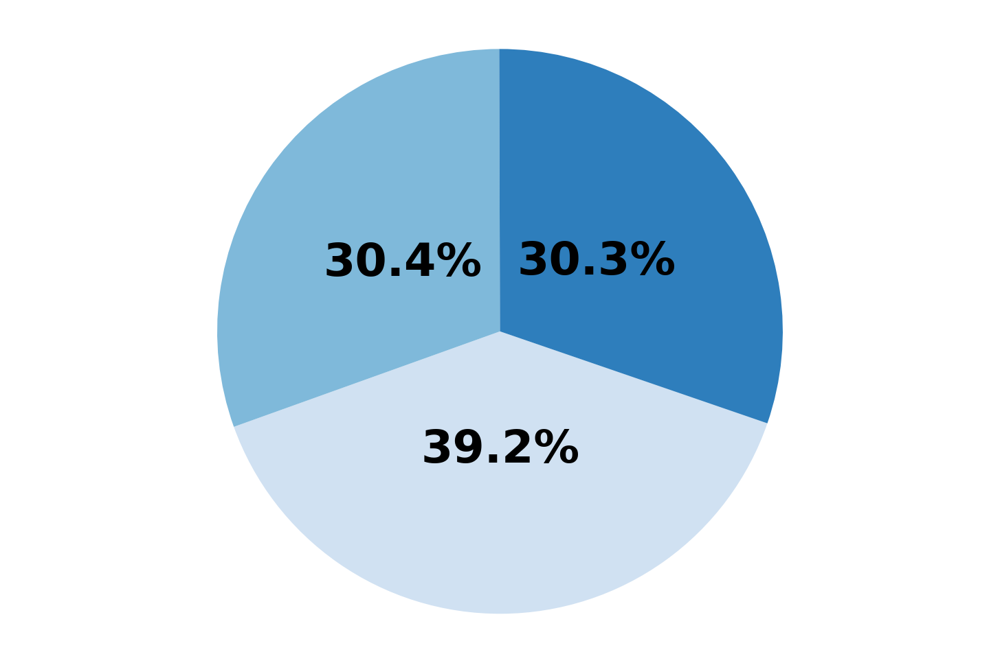

In [21]:
#perspective_dict

labels = perspective_dict.keys()

sizes = perspective_dict.values()
colors = plt.get_cmap('Blues')(np.linspace(0.2, 0.7, len(labels)))

explode = (0.03, 0.03, 0.03, 0.03, 0.03)  # explode 1st slice

# Plot
plt.pie(sizes, colors = colors, pctdistance = 0.42, autopct='%1.1f%%', counterclock = False, startangle=-19, labeldistance=0.73)
#labels=labels, 
plt.axis('equal')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/perspective_frequency.png', bbox_inches="tight")




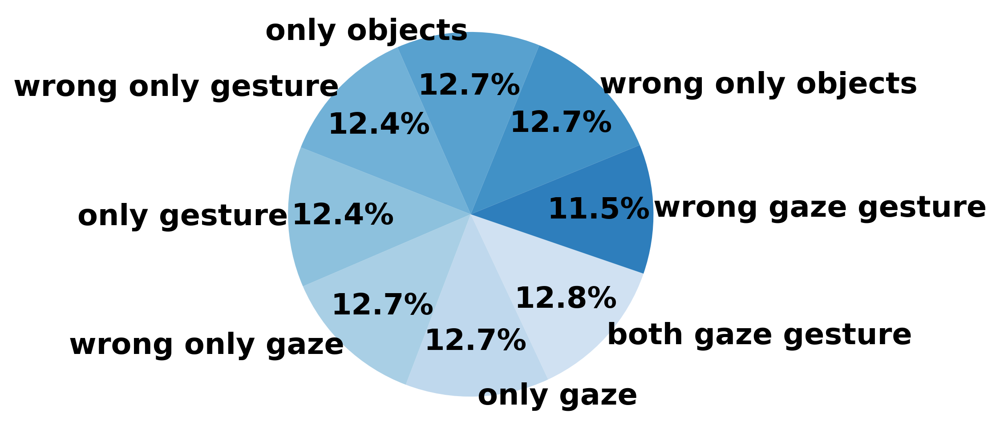

In [22]:
#situation_dict
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 16}

plt.rc('font', **font)

labels = situation_dict.keys()
sizes = situation_dict.values()
colors = plt.get_cmap('Blues')(np.linspace(0.2, 0.7, len(labels)))

explode = (0.03, 0.03, 0.03, 0.03, 0.03)  # explode 1st slice

# Plot
plt.pie(sizes, labels = labels, colors = colors, pctdistance = 0.7, autopct='%1.1f%%', counterclock = False, startangle=-19, labeldistance=1)
#labels=labels, 
plt.axis('equal')
plt.savefig('/project/CollabRoboGroup/abg4br/CAESAR-stats/figuresXL/situation_frequency.png', bbox_inches="tight")